# Chapter 11. Training Deep Neural Networks

## The Vanishing/Exploding Gradients Problems
* **The backpropagtion algorithm works by going from the output layer to the input layer, propagating the error gradient along the way.**
* **Once the algorithm has computed the gradient of the cost function with regard to each parameter in the network, it uses these gradients to update each parameter with a Gradient Descent step.**

#### Vanish Gradient Proble
* **Gradients often get smaller and smaller as the algorithm progresses down to the lower layers. As a result, the Gradient Descent update leaves the lower layers' connection weights virtually unchanged, adn the training never converges to a good solution.**

#### Exploding Gradients Porblem
* **The gradients can grow bigger and bigger until layers get insanely large weight updates and the algorithm diverges.**

##### More generally, deep neural networks suffer from unstable gradients; different layers may learn at widely differen speeds.
* ***Glorot and Bengio*: combination of the popular lohistoc sigmoid activation function and the weight initializtion technique(i.e, a normal distirbution with a mean of 0 and a standard deivation of 1)**
    * **The variance of the outputs of each layer is much greater than the variacne of its inputs. Going forward in the network, the variance keeps increasing after each layer until the activation function saturates at the top layer.**

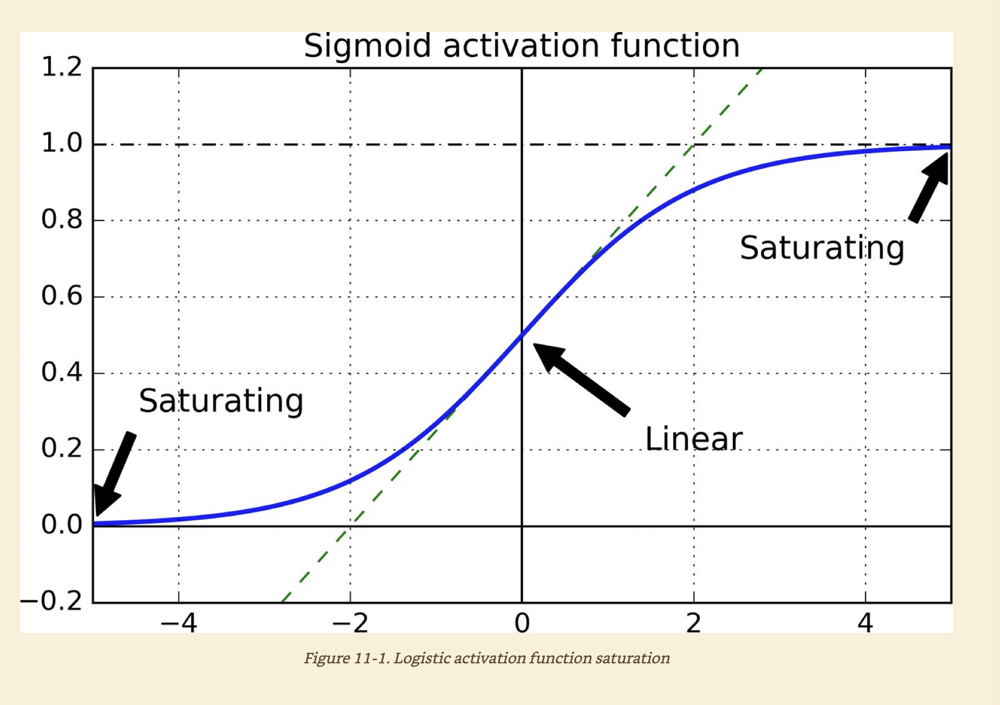
* **When inputs become large(negaive or positive), the function saturates at 0 or 1, with a derivative extremely close to 0.**
* **When backpropagation kicks in it has virtually no gradients to propagate back through the networks; and what little gradient exisits keeps getting dilluted as backpropagation progresses down through the top layers, so there is really nothing left for the lower layers.**

## Glorot and He Initialization
* **We need the signal to flow properly in both directions: in the forward direction when making predictions, and in the reverse direction when backpropagating gradients.**
* **We don't want the signal to die out, nor do we want it to explode and saturate.**
    * **For the signal to flow properly, we need the variance of the outputs of each layer to be equal to the variance of its inputs, and we need the gradients to have equal variance before and after flowing through a layer in the reverse direction.**
    * **Not possible to guarantee both unless the layer has an equal number of inputs and neurons(these numbers are called the $fan-in$ and $fan-out$ of the layer)**
    * **Glorot and Bengio prosed a good compromise that has proven to work well in practice: the connection weights of each layer must be initialized randomly, where $fan_{avg} = (fan_{in} + fan_{out})/2 $. This initialization strategy is called *Xavier initialization* or *Glorot initialization*.**
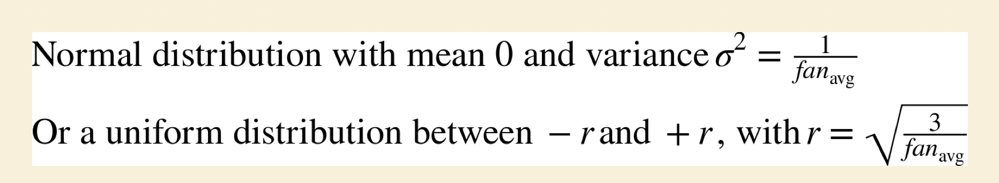

### LeCun Initialization
* **LeCun initilization is equivalent to Glorot intilization when $fan_{in} = fan_{out} $.**
* **The initialization strategy for the ReLU activation function(and its variants) is sometimes called *He intialization*.**
* **The SELU activation function should be used with LeCun initialization(preferably with a normal distribution)**
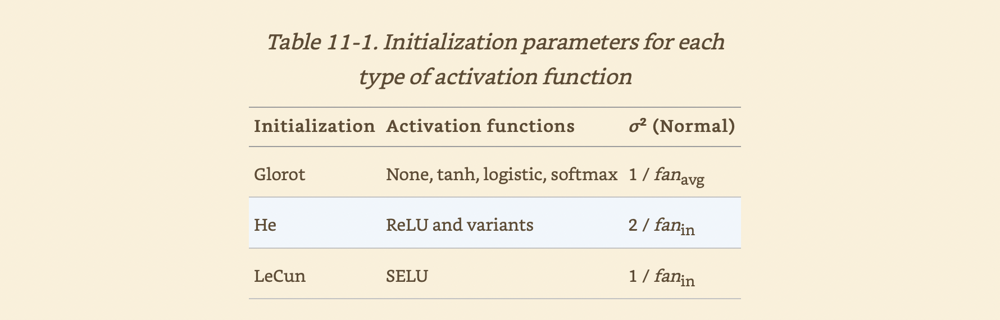

* **By default, keras uses Glorot intialization with a uniform distribution. When creating a layer, you can change this to He initialization by setting** kernel_initializer="he_uniform" **or** kernel_initializer="he_normal"

In [1]:
import tensorflow as tf

In [4]:
tf.keras.layers.Dense(10, activation="relu", kernel_initializer="he_normal")

* **If you want He initialization with a uniform distribution but based on** $fan_{avg}$ **rather than** $fan_{in}$, **you can use the** VarianceScaling **initializer like this:**

In [3]:
he_avg_init = tf.keras.initializers.VarianceScaling(scale=2, mode="fan_avg",
                                                distribution='uniform')
tf.keras.layers.Dense(10, activation="sigmoid", kernel_initializer=he_avg_init)

## Nonsaturating Activation Functions
* **Some activation functions behave better in deep neural networks-in particular, the ReLU activation function, mostly becuase it does not saturate for positive values(and because it is fast to compute.)**

#### Dying ReLU Problem
* **During training, some neurons effectively "die", meaning they stop outputting anything other than 0.**
    * **A neuron dies when its weights get tweaked in such a way that the weighted sum of its inputs are negative for all instances in the training set. Gradient Descent does not affect it anymore because the gradient of the ReLU function is zero whe its input is negative.**

* **To solve this problem, you can use a variant of the ReLU function, such as the *leaky ReLU*. This function is defined as
$$ LeakyReLU_{\alpha} = \max (\alpha z, z) $$**
    * **The hyperparameter $\alpha$ defines how much the function "leaks": it is the slope of the function for $z < 0$ and is typically set to $0.01$.**
    * **This small slope ensures that leaky ReLUs never die.**
    * *randomize leaky ReLU(RReLU)*, **where $\alpha$ is picked randomly in a given range during training and is fixed to an average value during testing. RReLU perfoms faily well and seemed to act as a regularizer(reducing th risk of overfitting the training set).**
    * *parametric leaky ReLU(PReLU)*, **where $\alpha$ is authorized to be learned during training(instead of being a hyperparameter, it becomes a parameter that can be modifed by backpropagation like any otehr parameter.)**
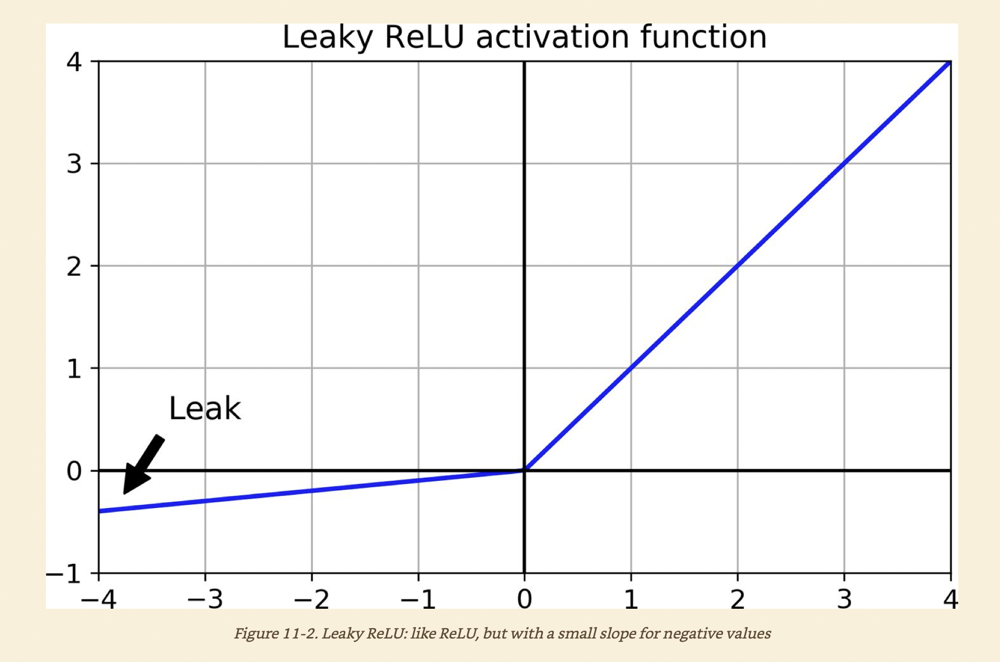

#### Exponential Linear Unit(ELU)
* **Outperforms all the ReLU variants in the author's experiments: training time was reduced, and the neural network performed better on the test**
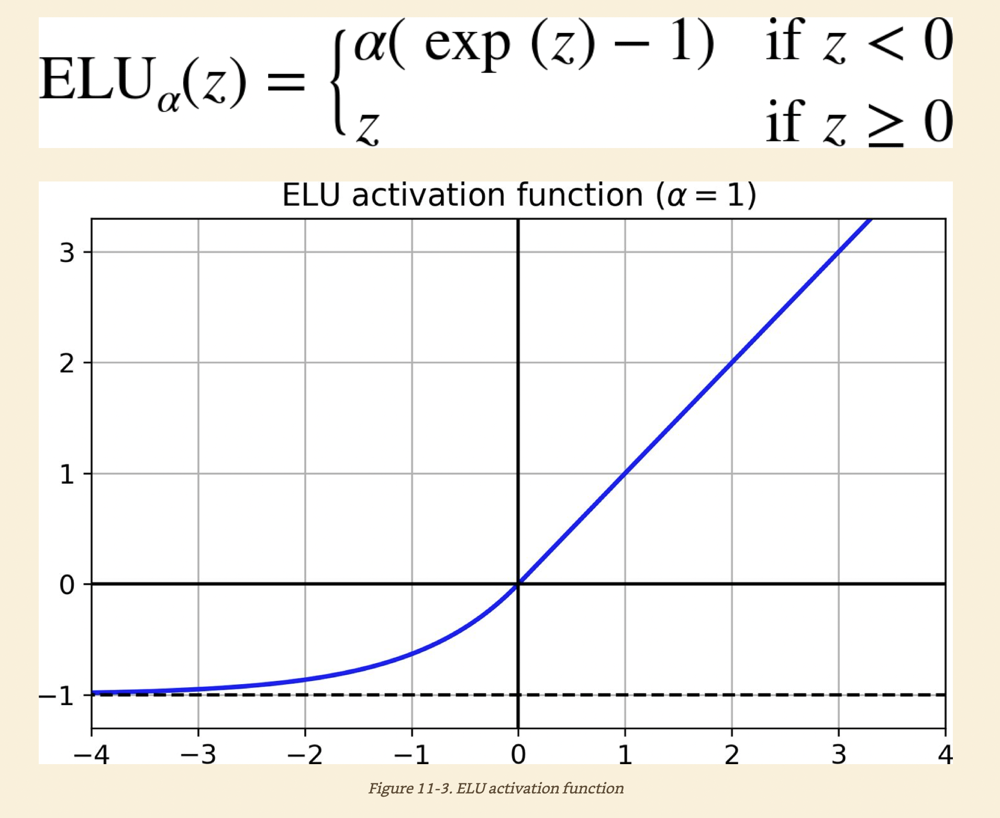
* **The ELU activation function looks a lot like the ReLU function, with a few major differences:**
    * **It takes on negative values when $z<0$, which allows the unit to have an average output closer to 0 and helps alleviate the vanishing gradient problem.**
    * **The hyperparameter $\alpha$ defines the value that the ELU function approaches when $z$ is a large negative number. It is usually set to 1, but you can tweak it like any other hyperparameter.**
    * **It has a nonzero gradietn for $z < 0$, which avoids the dead neuron problem.**
    * **If $\alpha$ is equal to 1 then the function is smooth everywhere, including around $z=0$, which helps speed up Gradient Descent since it does not bounce as musch to the let and right of $z = 0$**
    * **The main drawnack of the ELU activation function is that it is slower to compute than the ReLU function and its variants(due to the use of the exponential function).**
    
#### Scaled ELU (SELU) 
* **It is a scaled variant of the ELU activation function.**
* **It is shown that if you build a neural network composed exclusively of a stack of dense layers, and if all hidden layers use the SELU activation function, then the network will *self-normalize*.**
    * **The output of each layer will tend to preserve a mean of 0 and standard deviation of 1 during training, which solved the vanishing/exploding gradients problem.**
* **There are sveral conditions for self-normalization to happen**
    1. **Input features must be standardized(mean 0 and standard deviation 1).**
    1. **Every hidden layer's weights must be initialized with LeCun normal initalization. In keras, this means setting** kernel_intializer="lecun_normal"
    1. **The network's architecture must be sequential. Unfortunately, if you try to use SELU in nonsequential architectures, such as recurrent networks or networks with *skip connections*(i.e., connections that skip layers, such as in Wide&Deep nets), self-normalization will not be guarantted, so SELU will not necessarily outperform other activation functions.**
    1. **SELU only guarantees self-normalization if all layers are dense**<br>

**In general, SELU > ELU > leaky ReLU(and its variants) > ReLU > tanh > logistic.**
* **If the network's architecture prevents from self-normalizing, then ELU may perform better than SELU(since SELU is not smooth at z=0).**
* **If you care a lot about runtime latency, then you may prefer leaky ReLU. If you don't want to tweak another hyperparameter, you may use the default $\alpha$ values used by Keras.**
* **If you have spare time and computing power, you can use cross-validation to evaluate other activation functions, such as RReLU if your network is overfitting or PReLU if you have a huge training set.**


**To use the leaky ReLU activation function, create a** LeakyReLU **layer and add it to your model just after the layer you want to apply it to:**

In [2]:
import tensorflow as tf
import tensorflow.keras as keras

In [ ]:
model = keras.model.Sequential([
    [...]
    keras.layers.Dense(10, kernel_initializer="he_normal")
    keras.layers.LeakyReLU(alpha=0.2)
])

**For SELU activation, set** activation="selu" **and** kernel_initializer="lecun_normal" **when creating a layer:**

In [ ]:
layer = keras.layers.Dense(10, activation="selu", kernel_initializer="lecun_normal")

### Batch Normalization
* **Although using He initialization along with ELU(or any variant of ReLU) can significantly reduce the danger of the vanishing/exploding gradients problems at the beginning of the training, it doesn't guarantee that they won't come back during training.**
* ***Batch Normalization*(BN) addresses these problems.**
    * **The technique consists of adding an operation in the model just before or after the activation function of each hidden layer. This operation simply zerp-centers and normalizes each input, then scales and shifts the result using two new parameter vectors per layer: one for scaling, the other fot shifting**
    * **In many cases, if you add a BN layer as the very first layer of your neural network, you do not need to standardize your training set(e.g., using a** StandardScaler **); the BN layer will do it for you.**
    * **In order to zero-center and normalize the inputs, the algorithm needs to estimate each input's mean and standard deviation. It does so by evaluating the mean and standard deviation of the input over the current mini-batch.**

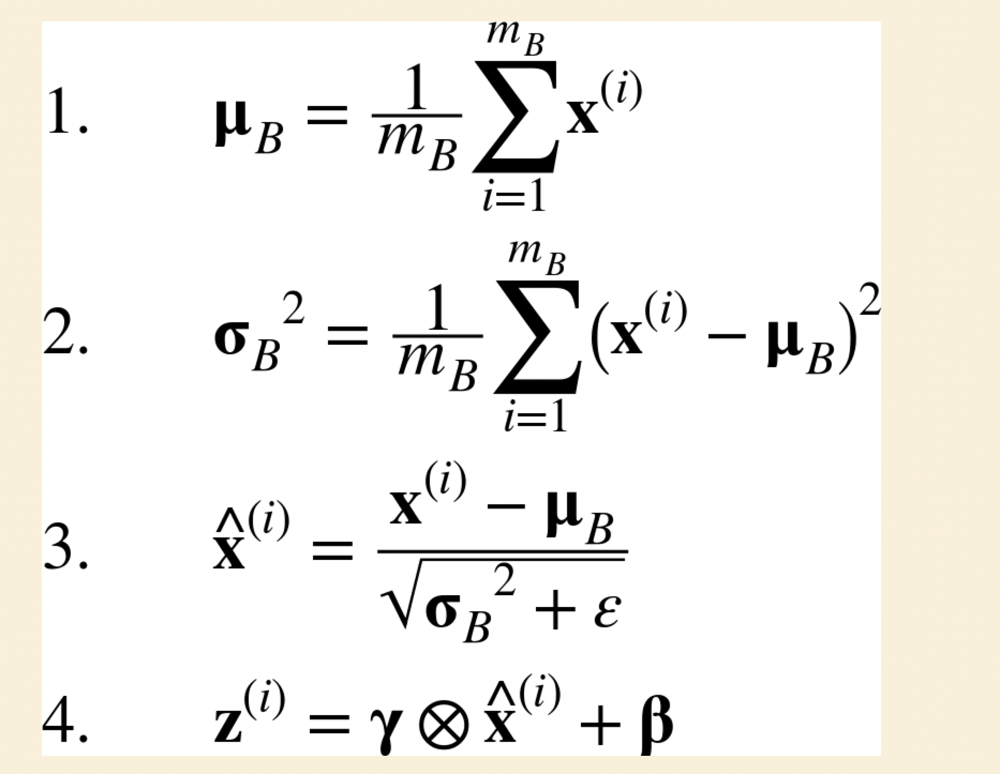
1. $\pmb{\mu} $ **is the vector of input means, evaluated over the whole mini-batch $B$ (it contians one mean per input).**
1. $\pmb{\sigma_B} $ **is the vector of input standard deviations, also evaluated over the whole mini-batch(it contains one standard deviation per input)**
1. $m_B$ **is the number of instances in the mini-batch.**
1. $\pmb{\hat{x}^{(i)}} $ **is the vector of zero-centered and normalized inputs for instance $ i $**
1. $ \gamma $ **is the output scale parameter vector for the layer(it contains one scale parameter per input).**
1. $ \otimes $ **represents element-wise multiplication(each input is multiplied by its corresponding output scale parameter).**
1. $ \beta $ **is the output shift(offset) parameter vector for the layer(it contains one offset parameter per input.) Each input is offset by its shift parameter.**
1. $ \varepsilon $ **is a tiny number that avoids division by zero(typically $ 10^{-5} $). This is called a *smoothing term*.**
1. $z^{(i)} $ **is the output of the BN operation. It is rescaled and shifted version of the inputs.**

#### Batch Normalization during Testing
* **During testing, most implementations of Batch Normalization estimates the input means and stnadard deviations by using a moving average of the layer's input means and standard deviations.**
    * **This is what Keras does automatically when you use the** BatchNormalization **layer.**
    * **Four parameter vectors are learned in each batch normalized layer: $\pmb{\gamma} $(the output scale vector) and $\pmb{\beta}$ (the output offset vector) are learned through regular backpropagation, and $\pmb{\mu}$ (the input mean vector) and $\pmb{\sigma}$ (the final input standard deviation vector) are estimated using an exponentail moving average.**<
    
#### Effects of Batch Normalization
* **Applying Batch Normalization, the vaninshing gradients problem was strongly reduced, to the point that they could use saturanting activation function such as tanh and even the logistic activation function.**
    * **The networks were much less sensitive to the weight initialization. The authours were able to use much larger learning rates, significantly speeding up the learning process.**
* **Batch Normalization acts like a regularizer, reducing the need for other regularization techniques(such as dropout).**
* **There is a runtime penalty: the neural network makes slower predictions due to the extra computations required at each layer.**
    * **Fortunately, it's often possible to fuse the BN layer with the previous layer's weights and biases so that it directly produces outputs of the appropriate scale and offset.**
        * **If the previous layer computes $ \pmb{XW} + \pmb{b} $, then  the BN layer will compute $\pmb{\gamma} \otimes ( \pmb{XW} + \pmb{b} - \pmb{\mu})/\pmb{\sigma} + \pmb{\beta} $**
        * **If we define $\pmb{W}^{'} = \pmb{\gamma} \otimes \pmb{W} / \pmb{\sigma}$ and $\pmb{b}^{'} = \pmb{\gamma} \otimes (\pmb{b - \mu})/ \pmb{\sigma} + \pmb{\beta}$, then equation simpliefies to $\pmb{XW^{'}} + \pmb{b^{'}}$**
        * **If we replace the precious layer's weights and biases($\pmb{W} $ and $ \pmb{b}$ with the updated weights and biases($\pmb{W^{'}}$ and $\pmb{b^{'}}$), we can get rid of the BN layer.**

#### Implementing Batch Normalization with Keras
* **Add a** BatchNormalization **layer before or after each hidden layer's activation function, and optionally add a BN as well as the first layer in yout model.**

In [3]:
model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=[28, 28]), 
    keras.layers.BatchNormalization(),
    keras.layers.Dense(300, activation="elu", kernel_initializer="he_normal"),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(100, activation="elu", kernel_initializer="he_normal"),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(10, activation="softmax")
])

In [5]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten (Flatten)            (None, 784)               0         
_________________________________________________________________
batch_normalization (BatchNo (None, 784)               3136      
_________________________________________________________________
dense (Dense)                (None, 300)               235500    
_________________________________________________________________
batch_normalization_1 (Batch (None, 300)               1200      
_________________________________________________________________
dense_1 (Dense)              (None, 100)               30100     
_________________________________________________________________
batch_normalization_2 (Batch (None, 100)               400       
_________________________________________________________________
dense_2 (Dense)              (None, 10)                1

* **See BN layer adds four parameters per input: $ \pmb{\gamma} $, $\pmb{\beta} $, $\pmb{\mu}$, and $\pmb{\sigma} $, the first two parameters, $\pmb{\mu} $ and $\pmb{\sigma}$, are the moving averages; they are not affected by backpropagation, so Keras calls them "non-trainable"(if you count the total number of BN parameters, $3,136 + 1,200 + 400 $, and divide by 2, you get $2,368$, which is the total number of non-trainable parameters in this model.)**

* **Looking at the parameres of the firs BN layer, two are trainable(by backpropagation), adn two are not**
* **when you create a BN layer in Keras, it also creates two operations that will be called by Keras at each iteration during training. These operations will update the moving averages.**

In [6]:
[(var.name, var.trainable) for var in model.layers[1].variables]

[('batch_normalization/gamma:0', True),
 ('batch_normalization/beta:0', True),
 ('batch_normalization/moving_mean:0', False),
 ('batch_normalization/moving_variance:0', False)]

* **To add the BN layers before the activation functions, you must remove the activation function from the hidden layers and add them as separate layers after the BN layers.**
* **Since a Batch Normalization layer includes one offset parameter per input, you can remove the bias term from the previous layer(just pass** use_bias=False **when creating it):**

In [8]:
model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=[28, 28]),
    keras.layers.BatchNormalization(),
    keras.layers.Dense(300, kernel_initializer="he_normal", use_bias=False),
    keras.layers.BatchNormalization(),
    keras.layers.Activation("elu"),
    keras.layers.Dense(100, kernel_initializer="he_normal", use_bias=False),
    keras.layers.BatchNormalization(),
    keras.layers.Activation("elu"),
    keras.layers.Dense(10, activation="softmax")
])

* **The** BatchNormalization **class has quite a few hyperparameters you can tweak. The defaults will usually be fine, but you may occasionally tweak the** momentum.
    * **This hyperparameter is used by the** BatchNormalization **layer whe it updates the exponential moving averages; given a new value** $\pmb{v}$ **(i.e., a new vector of input means or standard deviation computed over the current batch), the layer updates the running average $\hat{v} $ using the following equation:**
$$ \pmb{\hat{v}} \gets \pmb{\hat{v}} \times \mathsf{momentum} + \pmb{v} \times (1 - \mathsf{momentum})$$

* **Another important hyperparameter is** axis: **it determines which axis should be normalized. It defaults to -1, meaning that by default it will normalize the last axis(using the measn and standard deviations computed across *other* axes).**
    * **When the input batch is 2D(i.e., the batch shape is \[ *batch size, features* \]), this means that each input feature will be normalized based on the mean and standard deviation computed across all the instances in the batch.**
    * **If we move the first BN layer beforet the** Flateen **layer, the. the input batches will be 3D, with shape \[batch size, height, width\]; therefore, the BN layer will compute 28 means and 28 standard deviations(1 per column of pixels, computed across all instances in the batch and across all rows in the column), and it will normalize all pixels in a given column using the same mean and standard deviation.**
* **BN layer does not perform the same computation during training and after training: it uses batch statistics during training and the "final" statistics ager training(i.e., the final values of the moving averages).**

**Looking at the souce code**

In [ ]:
class BatchNoramilization(keras.layers.Layer):
[...]
    def call(self, inputs, training=None):
        [...]

* **The** call( ) **method is the one that performs the computation; it has an extra** training **argument, which is set to** None **by default, but the** fit( ) **method sets it to** 1 **during training.**

### Gradient Clipping
* **Another popular technique to mitigate the exploding gradients problem is to clip the gradients during backpropagation so that they never exceed some threshold.**
* **In keras, implementing Gradient Clipping is just a matter of setting the** clipevalue **or** clipnorm **argument when creating an optimizer**

In [ ]:
optimizer = keras.optimizers.SGD(clipvalue=1.0)
model.compile(loss="mse", optimizer=optimizer)

* **This optimizer will clip every component of the gradient vector to a value between** -1.0 **and** 1.0. 
    * **It may change the orientation of the gradient vector.**
    * **If you want to ensure the Gradient clipping does not change the direction of the gradient vector, you should clip by norm by setting** clipnorm **instead of** clipvalue.

## Reusing Pretrained Layers
* **It is genrally not a good idea to train a very large DNN from scratch: instead, you should always try to find an existing neural network that accomplishes a similar task to the one you are trying to tackle, then reuse the lower layers of this work.**
    * **This technique is called *transfer learning*. It will not only speed up training considerably, but also require significantly less training data.**
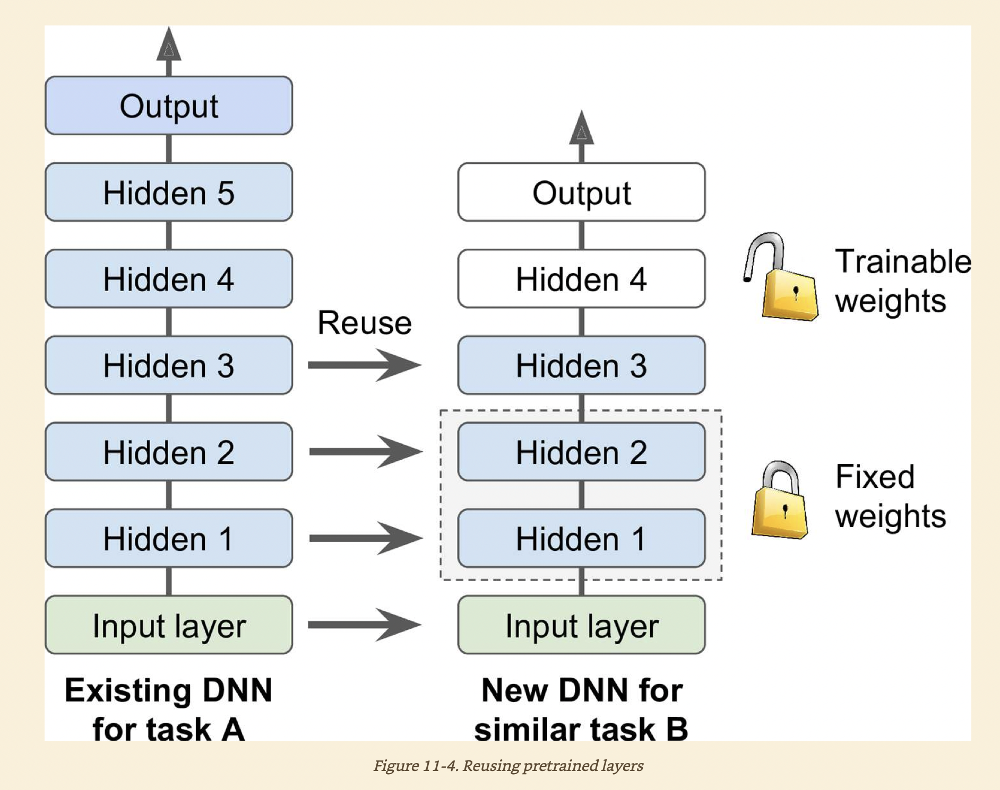

* **If the input of the new task don't have the same size as the ones used in the original task, you will have to add a preprocessing step to resize them to the size expected by the original model.**
    * **Transfer learning will work best when the inputs have similar low level features.**
* **The output of the original model should usually be replaced beacuse it is most likely not useful at all for the new task, and it may not even have the right number of outputs for the new task.**
* **The upper hidden layers of the original model are less likely to be as useful as the lower layers, since the high-level features that are most useful for the new task may differ significantly from the ones that were most useful for the original task.**
    * **Try freezing all the reused layers first(i.e., make their weights non-trainable so that Gradient Descent won't modify them), then train your model and see how it performs.**
    * **Try unfreezing one or two of the top hidden layers to let backpropagation tweak them and see if the performance improves.**
        1. **The more training data you have, the more layers you can unfreeze.**
        1. **It is also useful to reduce the learning rate when you unfreeze resued layers: this will avoid wrecking their fine-tuned weights.**
        1. **If you still cannot get good performance, and you have little training data, try dropping the top hidden layer(s) and freezing all the remaining hidden layers again. You can iterate until you find the right number of layers to reuse.**
        1. **If you have plenty of training data, you may try replacing the top hidden layers instead of dropping them, and even adding more hidden layers.**

#### Unsupervised Pretraining
**Suppose you want to tackle a complex task for which you don't have much labeled training data, but unfortuantely you cannot find a model trained on a similar task.**
1. **You should try to gather more labeled training data, but if you can't, you may still be able to perform unsupervised pretraiing.**
1. **If you can gather plenty of unlabeled training data, you can try to use it to train an unsupervised model, such as an autoencoder or a generative adversarial network.Then you can reuse the lower layers of the autoencoder or the lower layers of the GAN's discriminator, add the output layer for your task on top, and finetune the final network using supervised learning.**

####  Greedy layer-wise pretraining
* **First train an unsupervised model with a single layer, typically an RBM, then they would freeze that layer and add another one on top of it, then train the model again(effectively just training the new layer), then freeze the new layer and add another layer on top if it, train the model again, and so on.**
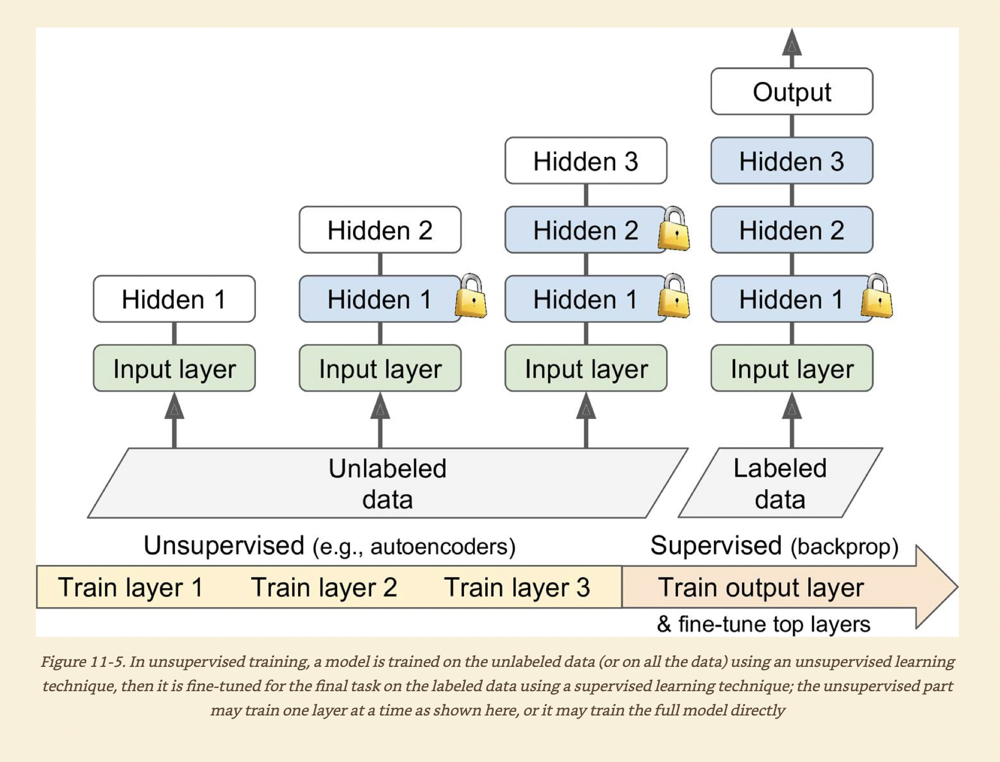

#### Pretraining on An Auxiliary Task
* **If you do not have much labeled training data, one last option is to train a firts neural network on an auxiliary task for which you can easily obtain or generate labeled training data, then reuse the lower layers of that network for your actual task.**
    * **The first neural network's layers will learn feature detectors that will likely be reusable by the second neural network.**

#### Self-Supervised Learning
* **Self-supervised learning is when you automatically generate the lables from the data itself, then you train a model on the resulting "labeled" dataset using supervised learning techniques.**
    * **Since this approach requires no human labeling whatsoever, it is best classified as a form of unsupervised learning.**

## Faster Optimizers
**Ways to speed up training**
* **Applying a good initialization strategy for the connection weights**
* **Using a good activation function**
* **Using Batch Normalization**
* **Reusing parts of a pretrained network(possibly built on an auxiliary task or using unsupervised learning).**
* **Using a faster optimizer than the regular Gradient Descent optimizer.**

### Momentum Optimization
* **Graditen Descent updates the weights $\theta$ by directly subtracting the gradient of the cost function$J(\theta)$ with regard to the weights $(\nabla_{\theta} J(\theta))$ multiplies by the learning rate $\eta$).**
   $$ \theta \space \gets \space \theta - \eta \nabla_{\theta} J(\theta)$$
    * **If the local gradient is tiny, it goes very slowly.**
* **Momentum optimization cares a great deal about what previous gradients were:**
    * **At each iteration, it subtracts the local gradient from the *momentum vector* $\pmb{m}$ (multiplies by the learning rate $\eta$), and it updates the weights by adding this momentum vector.**
    * **In other words, the gradient is used for acceleration, not for speed.**
    * **To smulate some sort of friction mechanism and prevent the momentum from growing too large, the algorithm introduces a new hyperparameter $\beta$, called the *momentum*, which must be set between 0(high friction) and 1(no friction)**
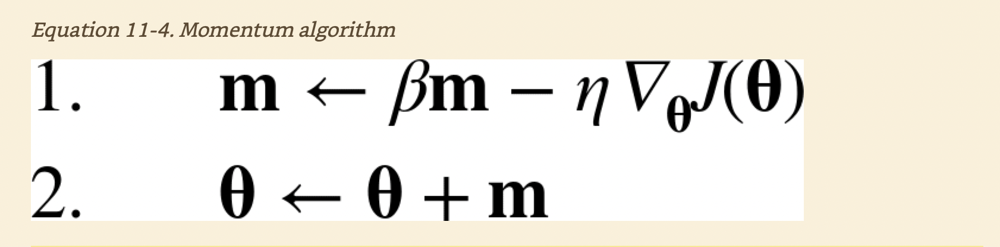
* **If the gradient remains constant, the terminal velocity(i.e., the maximum size of the weight updates) is equal to that gradient multiplied by the learning rate $\eta$ multiplies by $1/(1- \beta) $(ignoring the sign).**
    * **This allows momentum optimization to escape from plateaus much faster than Gradient Descent**
    * **Momentum optimization will row down the valley faster and faster until it reaches the bottom(the optimum).**
    * **In deep neural networks that don't use use Batch Normalization, the upper layers will often end up having inputs with very different scales, so using momentum optimization helps a lot. It can also help past local optima.**
    * **Due to the momentum, the optimizer may overshoot a bit, then come back, overshoot again, and oscillate like this many times before stabilizing at the minimum. The friction helps to get rid of these oscillations and thus speeds up convergence.**

**Implementing momentum oprimization in keras**<br>
* **The one drawback of momentum optimization is that it adds yet another hyperparameter to tune.**

In [ ]:
optimizer = keras.optimizer.SGD(lr=0.001, momentum=0.9)

### Nesterov Accelerated Gradient

#### Nesterov Accelerated Gradient(NAG) 
* **Measures the gradient of the cost function not at the local postion $\theta$ but slightly ahead in the direction of the momentum, at $\theta + \beta \pmb{m} $**
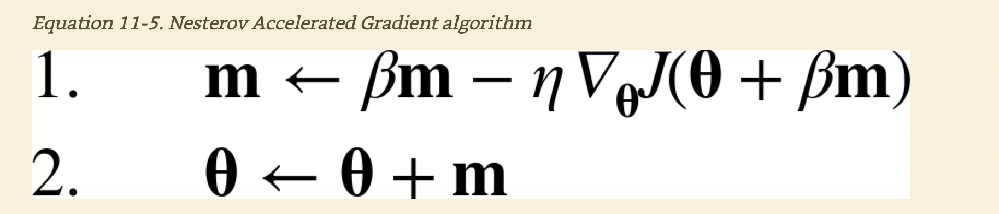
    * **In general, the momentum vector will be pointing in the right direction(i.e., toward the optimum), so it will be slightly more accurate to use the gradient measured a bit farther in that direction rather than the gradient original position**
    
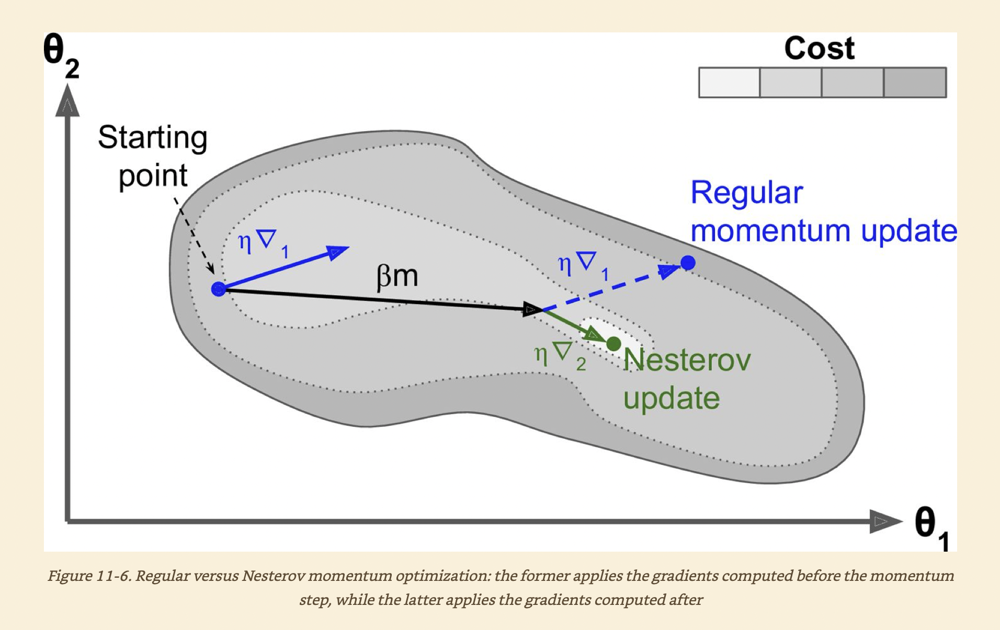
**Where $\nabla_1 $ represents the gradient of the cost function measured at the starting point $ \theta$, and $\nabla_2$ represents the gradient at the point located at $\theta + \beta \pmb{m} $**

* **The Nesterov update ends up slightly closer to the optimum. This results in NAG being signifivantly faster than regular momentum optimization.**
* **When the momentum pushes the weight across a valley, $ \nabla_1$ continues to push farther across the valley, while $ \nabla_2 $ pushes back toward the bottom of the valley. This helps reduce oscillations and thus NAG converges faster.**

**Implementing NAG**

In [ ]:
optimizer = keras.optimizers.SGD(lr=0.001, momentum=0.9, nesterov=True)

### AdaGrad
* **Gradient Descent starts by quickly going down the steepest slope, which does not point straight toward the global optimum, then it bery slowly goes down to the bottom of the valley.**
* **AdaGrad could correct its direction earlier to point a bit more toward the global optimum.**
    * **AdaGrad algorithm achieves this correction by scaling down the gradient vector along the steepest dimensions.**
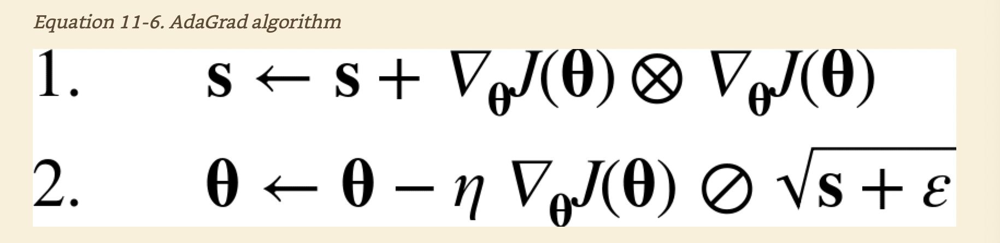
1. **The first stpe accumulates the square of the gradients into the vector S(recall that the $\otimes$ represents element-wise multiplication).**
    * **This vectorized form is equivalent to computing $s_i \gets s_i + (\partial(J(\theta) / \partial (\theta)^2 $ for each element $s_i$ of the vector $\pmb{s}$.**
    * **In other words, each $s_i$ accumulates the squares of the partial derivative of the cost funcrtion with regard to parameter $\theta_i$. If the cost function is steep along the ith diemnsion, the $s_i$ will get larger and larger at each iteration.**
1. **The second step is almost identical to Gradient Descent, but with one big differecel: the gradient vector is scaled down by a factor of $ \sqrt{\pmb{S + \varepsilon}}$**
    * **The $\oslash$ symbol represents the element-wise divisio n, and $\varepsilon$ is a smoothing term to avoid division by zero.**
    * **This vectorized form is equivalent to simultaneously computing $ \theta_i \gets \theta_i - \eta \partial \pmb{J(\theta)} / \partial \theta_{i} / \sqrt{s_i + \varepsilon}$ for all parameters $\theta_i$**

* **In short, this algorithm  decays the learning rate, but it does so faster for steep dimensions than for dimensions with gentler slopes.**
    * **This is called an *adaptive learning rate.* It helps point the resulting updates more directly toward the global optimum. One additional benefit is that it requires much less tuning of the learning hyperparameter $\eta$.**

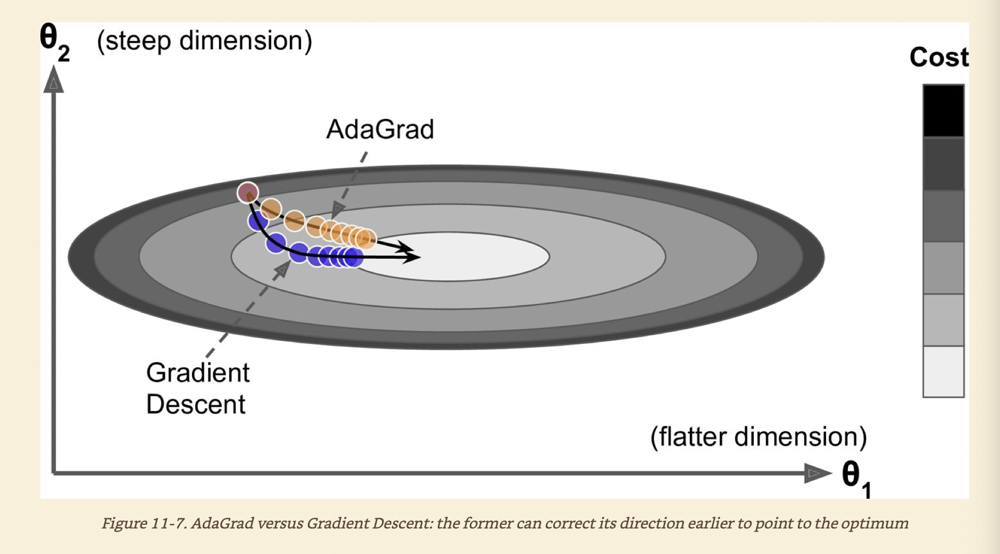



* **AdaGrad frequently performs well for simple quadratic problems, but it often stops too early when training neural networks.**
    * **The leraning rate gets scaled down so much that the algorithm ends up stopping entirely before reaching the global optimum.**

### RMSProp
* **The RMSProp algorithm fixes this by accumulating only the gradients from the most recent iterations(as opposed to all the gradients at the beginning of training). It does so by using exponential decay in the first step.**
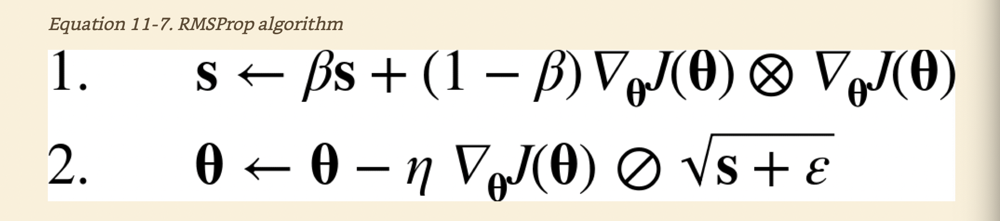
* **The decay rate $\beta$ is tupically set to 0.9.**

**Implementing RMSProp**
* **The** rho **argument corresponds to** $\beta$. 

In [ ]:
optimizer = keras.optimizers.RMSprop(lr=0.001, rho=0.9)

### Adam and Nadam Optimization
* **Adam, which stands for *adaptive moment estimation*, combines the ideas of momentum optimization and RMSProp: just like momentum optimization, it keeps track of an exponentially decaying average of past gradients; and just like RMSProp, it keeps track of an exponentially decaying average of past squared gradients.**
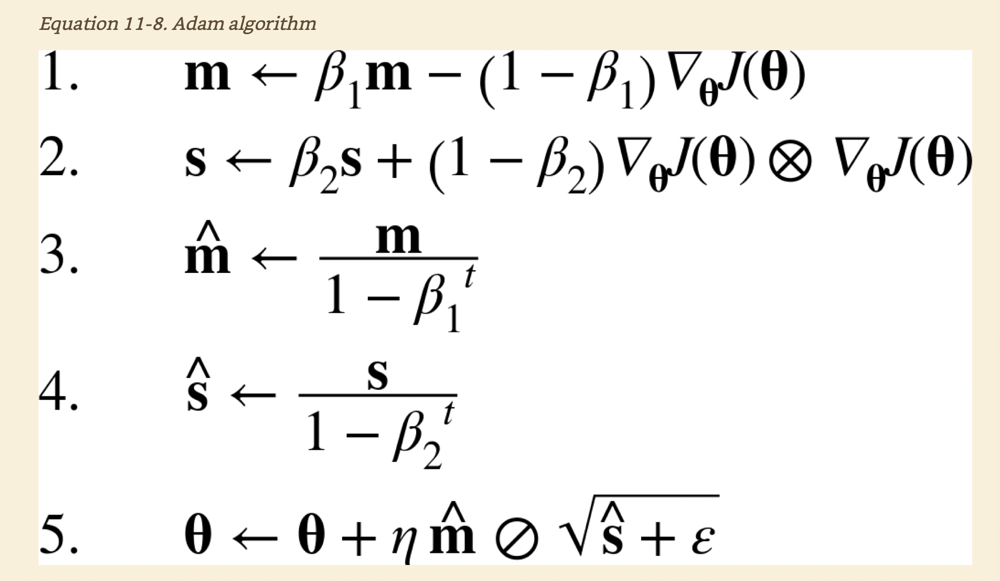
* **In this equation, $t$ represents the iteration number(starting at 1).**

* **Step 1, 2, 5 resembles closely with momentum optimization and RMSProp.**
* **Step 3 and 4 will help boost $\pmb{m} $ amd $\pmb{s} $ at the beginning of training.**
* **The momentum decay hyperparamete $\beta_1$ is typically intilized to 0.9, while the scaling decay hyperparameter $\beta_2$ is often initilized to 0.999.**
* **The smoothing term $\varepsilon$ is usually initialized to a tiny number such as $10^{-7}$.**

**Implemetning Adam optimizer in Keras.**

In [ ]:
optimizer = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

**Since Adam is an adaptive learning rate algorithm(like AdaGrad and RMSProp), it requires less tuning of the learning rate hyperparameter $\eta$. You can often use the default value $\eta=0.001$, making Adam even easier to use than Gradient Descent.**

#### AdaMax
* **Adam accumulates the squares of the gradients in $\pmb{s}$(with a greater weight for more recent gradient**
    * **In step 5, Adam scales down the parameter updates by the square root of $\pmb{s}$. In short, Adam scales down the parameter updates by the $\mathcal{l}_2$ norm of the time-decayes gradients(the $\mathcal{l}_2$ is the square root of the squares.**
* **AdaMax replaces the $\mathcal{l}_2 $ norm with the $\mathcal{l}_\infty$ norm(max).**
    * **It replaces step 2 with $ \pmb{s} \gets \max(\beta_2 \pmb{s}, \nabla_\theta J(\pmb{\theta})$, drops step 4, and in step 5 it scales down the gradient updates by a factor of $\pmb{s}$, which is just the max of time-decayes gradients.**
* **In practice, this can make AdaMax more stable than Adam, but it really depends on the dataset, and in general Adam performs better.**
#### Nadam
* **Nadam optimization is Adam optimization plus the Nesterov trick, so it will often converge slightly faster than Adam.**

**All the optimization techniques discussed so fat only rely on the *first-order partial derivatives(Jacobians)*.**

### Learning Rate Scheduling
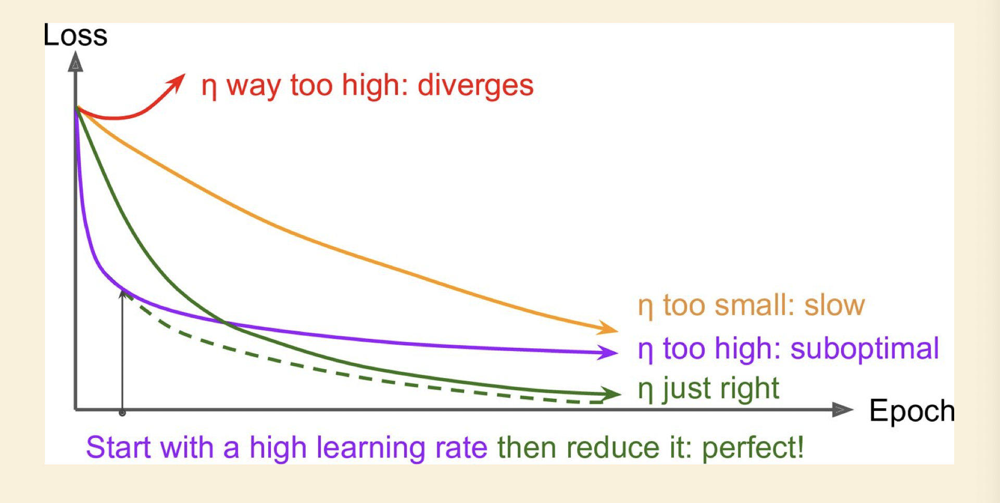
* **If you set the learning rate too low, training will eventually converge to the optimum, but it will take a long time.**
* **If you set it slightly too high, it will make progress very quickly at first, but it will end up dancing around the optimum, never quickly settling down.**

#### Learning shcedules
* **If you start with a large learning rate and then reduce it onece training stops making fast progress, you can reach a good solution faster than with the optimal constant learning rate.**
* **There are many strategies to reduce learning rate during training, these strategies are called learning schedule.**

##### Power Schueduling
* **Set the learning rate to a function of the iteratio number $t: \eta (t) = \eta_0 / (1 + t/s)^c $.**
* **The initial learning rate $\eta_0$, the power $c$(typically set to 1), and the steps $s$ are hyperparameters.**
* **The schedule first drops quickly, then more and more slowly.**

##### Exponential Scheduling
* **The learning rate will gradually drop by a factor of 10 every** s **steps. While power scheduling reduces the learning rate more and more slowly, exponential scheduling keeps slashing it by a factor of 10 every *s* steps.**

##### Piecewise Constant Scheduling
* **Use a constant learning rate for a number of epochs, then a smaller learning rate for another number of epochs, and so on.**

##### Performance Scheduling
* **Measure the validation error every N steps(just like for early stopping), and reduce the learning rate by a factor of $\lambda$ when the error stops dropping.**

##### 1cycle scheduling
* ***1cycle* starts by increasinng the initial learning rate $\eta_0$, growing linearly up to $\eta_1$ halfway through the training. Then it decreases the learning rate linealy down to $\eta_0$ again during the second half of training, finishing the last few epochs by dropping the rate down by several orders of magnitude(still linearly).**
    * **The maximal learning rate $\eta_1$ is chosen using the same approach we used to find the optimal learning rate, and the initial learning rate $\eta_0$ is chosen to be rougly 10 times lower.**
* **This apporach was often able to speed up training considerably and reach better performance.**

**Implementing power scheduling in Keras**<br>
* **The** decay **is the inverse of *s*(the number of steps it takes to divide the learning rate by one more unit), and keras assumes that *c* is equal to 1.**

In [ ]:
optimizer = keras.optimizers.SGD(lr=0.01, decay=1e-4)

**Implementing Exponential scheduling**<br>
* **First you need to define a function that takes the current epoch and returns the learning rate.**

In [ ]:
def exponential_decay_fn(epoch):
    return 0.01 * 0.1**(epoch/20)

**If you do not want to hardcode $\eta_0$ and $s$, you can create a function that returns a configured function:**

In [ ]:
def exponential_decay(lr0, s):
    def exponential_decay_fn(epoch):
        return lr0 * 0.1**(epoch / s)
    return exponential_decay_fn

In [ ]:
exponential_decay_fn = exponential_decay(lr0=0.01, s=20)

* **Create a** LearningRateScheduler **callback, giving it the schedule function, and pass this callback to the** fit( ) **method.**
* **The** LearningRateScheduler **will update the optimizer's** Learning_rate **attribute at the begining of each epoch**

In [ ]:
lr_scheduler = keras.callbacks.LearningRateScheduler(exponential_decay_fn)
history = model.fit(X_train_scaled, y_train, [...], callbacks=[lr_scheduler])

* **The schedule function can optionally take the current learning rate as a second argument.**
    * **This implementaton relies on the optimizer's initial learning rate.**
    * **When you save a model, the optimizer and its learning rate get saved along with it.**
* **If your schedule function uses the epoch argumetn, however: the epoch does not ger saved, and it gets reset to 0 everytime you call the** fit( ) **method.**

In [ ]:
def expoential_decay_fn(epoch, lr):
    return lr * 0.1**(1 / 20)

* **For piecewise constant scheduling, you can use a schedule function**
* **Then create a** LearningRateScheduler **callback with this function and pass it to the** fit( ) **method.**

In [ ]:
def piecewise_constant_fn(epoch):
    if epoch < 5: 
        return 0.001
    elif epoch < 15:
        return 0.005
    else:
        return 0.001

* **For performance scheduling, use the** ReduceLROnPlateau **callback.**
    * **If you pass the folowing callback to the** fit( ) **method, it will multiply the learning rate by 0.5 whenever the best validation loss does not improve for five consecutive epochs.**

In [ ]:
lr_scheduler = keras.callbacks.ReduceLROnPlateau(factor=0.5, patience=5)

#### Alternative Learning Rate Scheduling Implementation
* **tf.keras offers an alternative way to implement learning rate scheduling: define the learning rate using one of the schedules availiable in** keras.optimizers.schedules, **then pass this learning rate to any optimizer.**
    * **This approach updates the learning rate at each step rather than at each epoch.**

**Implementing Exponential Decay**

In [ ]:
s = 20 * len(X_train)
learning_rate = keras.optimizers.schedules.ExponentialDecay(0.01, s, 0.1)
optimizer = keras.optimizers.SGD(learning_rate)

## Avoiding Overfitting Through Regularization

### $\mathcal{l}_1$ and $\mathcal{l}_2 $ Regularization
* **You can use $\mathcal{l}_2$ regularization to constrain a neural network's weights, and /or $\mathcal{l}_1$ regularization if you want a sparse model(with many weights equal to 0).**

**Applying $\mathcal{l}_2$ regularization to a Kera layer's connection weights, using a regularization factor of** 0.01:
* **The** $l_2( ) $ **function returns a regularizer that will be called at each step during training to compute the regularization loss. This is the added to the final loss.**
* **You can just use** keras.regularizers.l1() **if you want $\mathcal{l}_1$ regularization.**
* **If you want both $\mathcal{l}_1$ and $\mathcal{l}_2$ regularization, use** keras.regularizers.l1_l2( ).

In [ ]:
layer = keras.layers.Dense(100, activation="elu", kernel_intializer="he_normal",
                          kernel_regularizer=keras.regularizers.l2(0.01))

* **Since you will typically want to apply the same regularizer to all layers in your network, as well as using the same activation function and same initialization strategy in all hidden layers, you can avoid DRY byy using python's** functools.partial( ) **function, which lets you create a thin wrapper for any callable, with some default arguement values:**

In [3]:
from functools import partial
RegularizedDense = partial(keras.layers.Dense,
                          activation="elu",
                          kernel_initializer="he_normal",
                          kernel_regularizer=keras.regularizers.l2(0.01))

model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=[28, 28]),
    RegularizedDense(300),
    RegularizedDense(100),
    RegularizedDense(10, activation="softmax", kernel_initializer="glorot_uniform")
])

### Dropout 
* **At every training step, every neuron(including the input neurons, but always excluding the output neurons) has a probability *p* of being temporarily "dropped out", meaning it will be entirely ignored during this training step, but it may active during the next step.**
* **The hyperparameter *p* is called the *dropout rate*, and it is typically set between 10% and 50%: closer to 20-30% in recurrent neural nets, and closer to 40-50% in convolutional neural networks.**
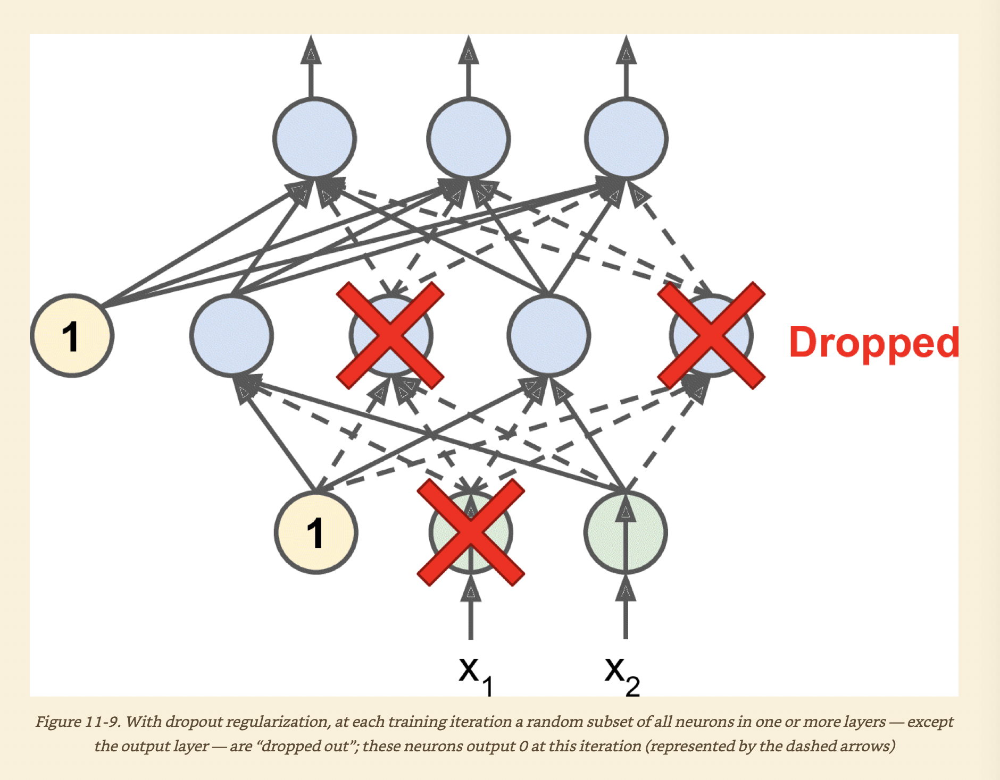
    * **Since each neuron can be either present or absent, there are a total of $2^N$ possible networks(where *N* is the toal number of droppable neurons).**
    * **The resulting neural network can be seen as an averaging ensemble of all these smaller neural networks.**
* **We need to multiply each input connection weight by the *keep probability*(1 - p) after training.**
    * **Alternatively, we can divide each neuron's output by the keep probability during training.**

In [4]:
model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=[28, 28]),
    keras.layers.Dropout(rate=0.2),
    keras.layers.Dense(300, activation="elu", kernel_initializer="he_normal"),
    keras.layers.Dropout(rate=0.2),
    keras.layers.Dense(100, activation="elu", kernel_initializer="he_normal"),
    keras.layers.Dropout(rate=0.2),
    keras.layers.Dense(10, activation="softmax")
])

* **Since dropout is only active during training, comparing the training loss and the validation loss can be misleading.**
* **Make sure to evaluate the training loss without dropout.**
* **If you observe that the model is overfitting, you can increase the dropout rate. Conversely, you should try decresing the dropout rate if the model underfits the training set.**
* **Dropout does tend to significantly slow down convergence, but it will usually result in a much better model when tuned properly.**
* **If you want to regularize a self-normalizing network, based on the SELU activation function, you should use *alpha dropout*: this is a variant of dropout that preserves the mean and standard deviation of its inputs.**

### Monte Carlo(MC) Dropout

#### Implmentation

In [5]:
import numpy as np

In [ ]:
y_probas = np.stack([model(X_test_scaled, training=True)
                    for sample in range(100)])

In [ ]:
y_proba = y_probas.mean(axis = 0)

* **The** model(X) **is similar to** model.predict(X) **except it returns a tensor rather than a NumPy array, and it supports the** training **argument**
* **Setting** training=True **ensures that the** Dropout **layer remains active,  so all predictions will be a bit different.***
    * **Each call to the model returns a matrix with one row per instance and one column per class. Because there are 10,000 instances in the test set and 10 classes, this is a matrix of shape \[10000, 10\]. We stack 100 scuh matrices, so $y_probas$ is an array of shape \[100, 10000, 10\].**
    * **Once we average over the first dimension($axis=0$), we get** y\_proba, **like we would get with a single prediction.**
    * **Averaging over multiple predictions with dropout on gives us a Monte Carlo estimate that is generally more reliable than the result of a single prediction with dropout.**
* **The number of Monte Carlo samples you use(100 in this example) is a hyperparameter you can tweak. The higher it is, the more accurate the predictions and their uncertainty estimates will be.**

* **If your model contains other layers that begave ina special way during training(such as** BatchNormalization **layers), then you should replace the** Dropout **layers with the following** MCDropout **class.**

In [ ]:
class MCDropout(keras.layers.Dropout):
    def call(self, inputs):
        return super().call(inputs, training=True)

**We just subclass the** Dropout **layer and override the** call( ) **method to force its** training **argument to** True.

### Max-Norm Regularization 
* **For each neuron, it constrains the weights $\pmb{w}$ of the incoming conncections such that $ \| \pmb{w} \| \leq r$, where r is the max-norm hyperparameter and $ \| \cdot \| $ is the $\mathcal{l}_2$ norm.**
* **Max-norm regularization does not add a regularization loss term to the overall loss function, t is typically implemented by computing $\| \pmb{w} \| $ after each training step and rescaling $\pmb{w}$ if needed($ \pmb{w} \gets \pmb{w} \space r / \| \pmb{w}\|_2$)**
* **Reducing $r$ increases the amount of regularization and helps reduce overfitting. Max-norm regularization can also help allevicate the unstable gradients problem.**

**Implementing max-norm regularization in Keras**<br>
* **Set the** kernel_constraint **argument of each hidden layer to a** max_norm( ) **constraint with the appropriate max value.**

In [ ]:
keras.layers.Dense(100, activation="elu", kernel_initializer="he_normal",
                  kernel_constraint=keras.constraints.max_norm(1.`))

* **After each training iteration, the model's** fit **method will call the object returned by** max_norm( ) , **passing it the layer's weights and getting rescaled weights in return, which then replace the layer's weights.**
* **The** max_norm( ) **function has an** axis **argument that defaults to** 0.
    * **A** Dense **layer usually has weights of shape** \[number of inputs, number of neurons\], **so using** axis = 0 **means that the max-norm constriaint will apply independently to each neuron's weight vector.**
    * **If you want to use max-norm with convolutional layers, make sure to set the** max_norm( ) **constraint's** axis **argument**(axis = \[0,1,2\])

## Practical Guidelines
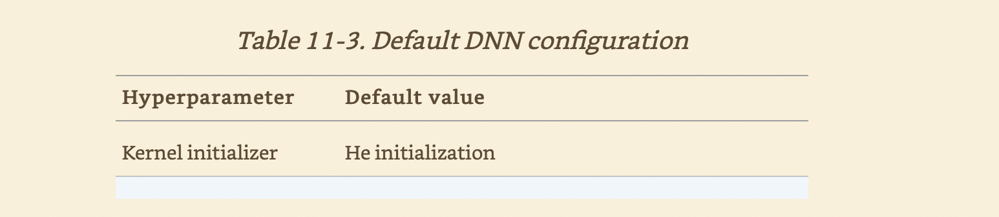
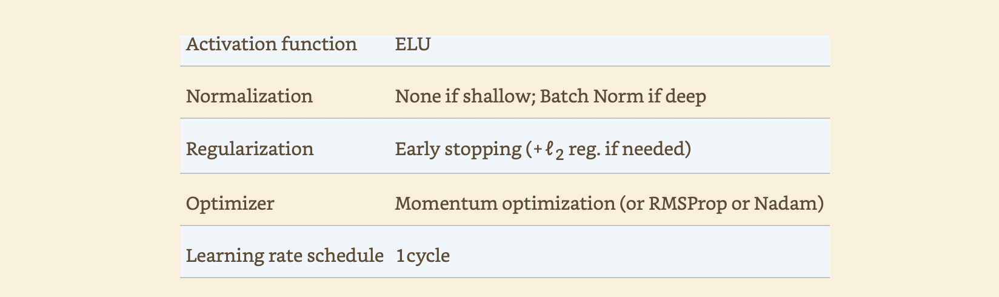

**For a netowrk that is composed of a simple stack of layers.**
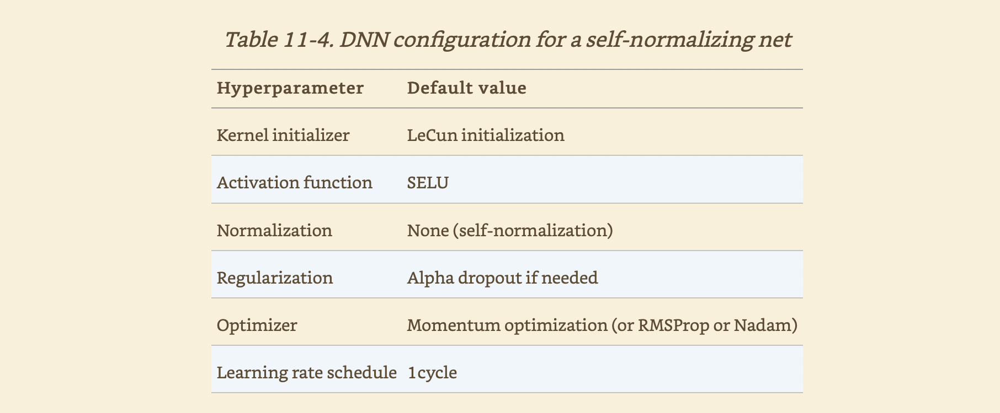